# **Did Somebody Say Corgi? - Dataset**

## **Imports and Constants**

In [1]:
import pandas as pd
from os.path import join as opjoin
import utils
import random
import ipyplot
from PIL import Image, ImageDraw
import os
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm import tqdm
import multiprocessing
import math
from threading import Thread
import numpy as np
from pathlib import Path

DATA_DIR = 'H:\\dataset'
IMAGE_DIR = 'H:\\dataset\images'
LABEL_DIR = 'H:\\dataset\labels'

In [ ]:
data = [Path(x).stem for x in os.listdir(LABEL_DIR) if Path(x).suffix == '.txt']
print(f'{len(data)} labeled images...')

## **Remove Duplicates**

Find duplicates using [imgdupes](https://github.com/knjcode/imgdupes) Perceptual Hashing (PHash) method.

In [ ]:
!imgdupes dataset/images phash 4 --dry-run --log --sort imagesize --num-proc 5 --ngt

Explore the results.

In [7]:
log_file = opjoin(DATA_DIR, 'imagedupes_log.log')
duplicates = [[]]
with open(log_file, 'r') as f:
    for l in f:
        if l == '\n':
            duplicates.append([])
        else:
            duplicates[-1].append(l.rstrip())

1th example



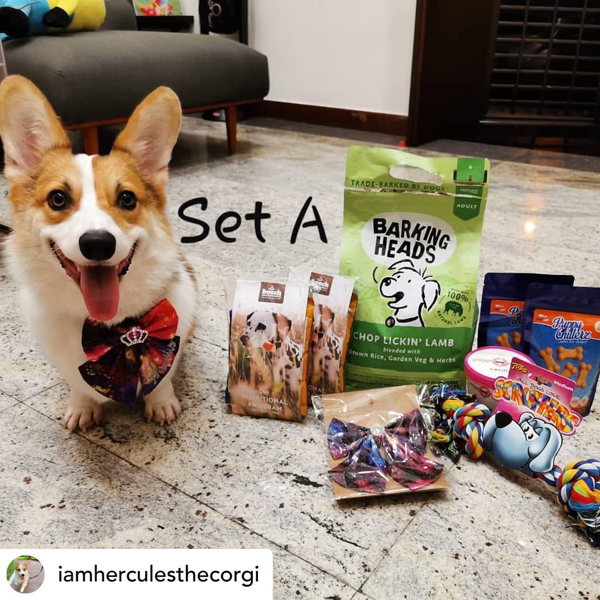
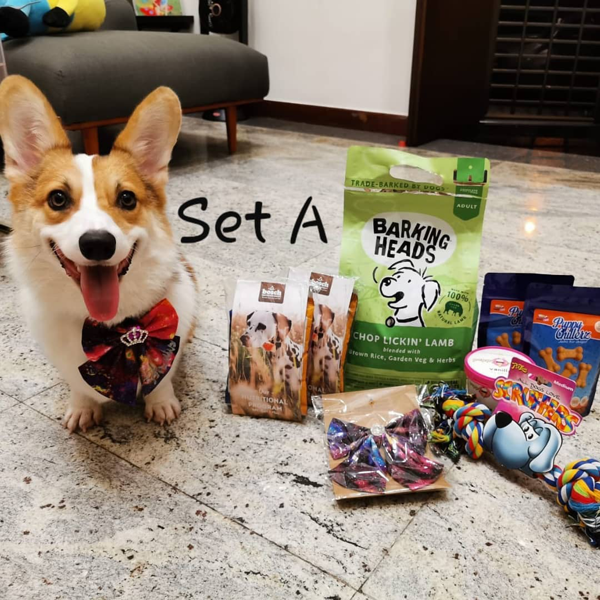

2th example



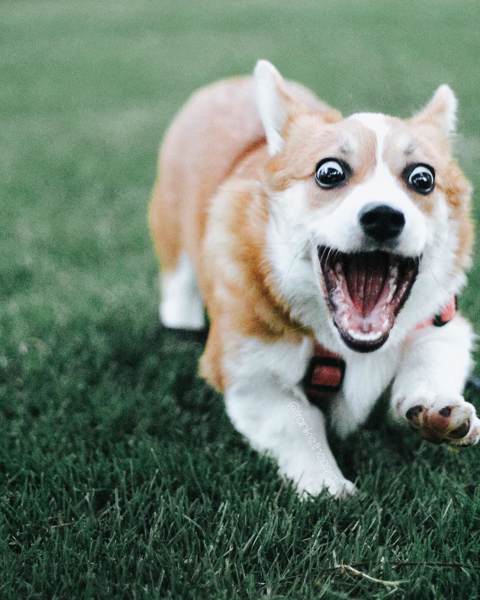
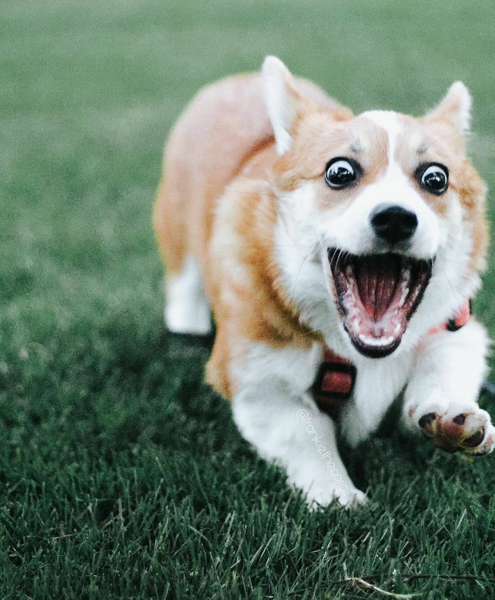

3th example



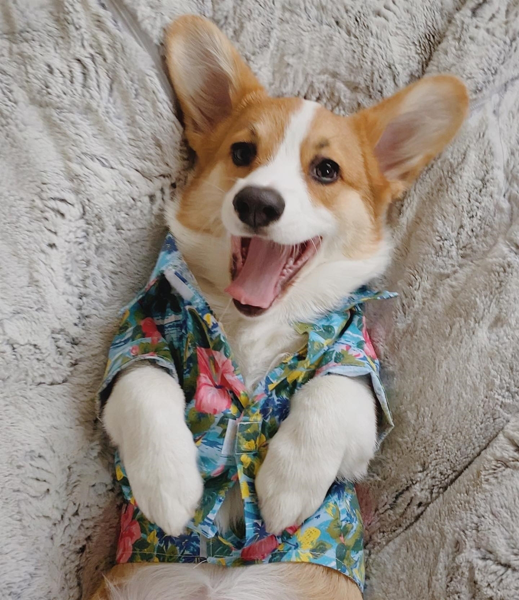
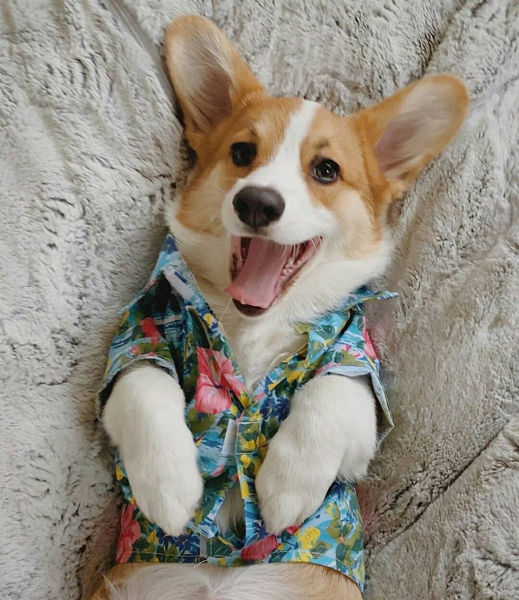

4th example



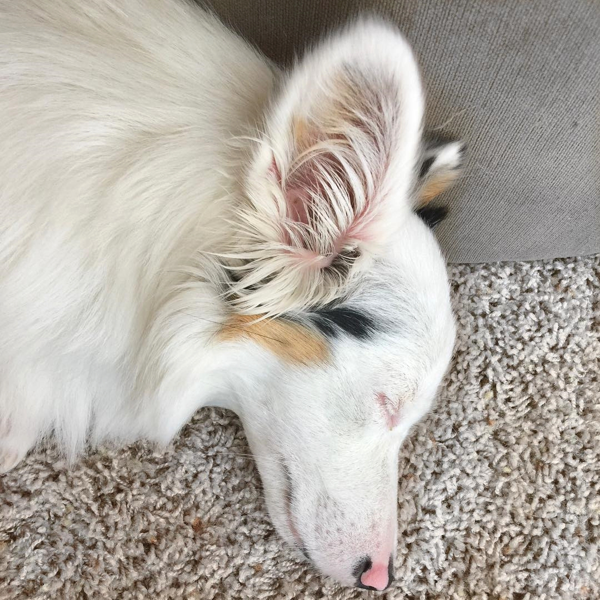
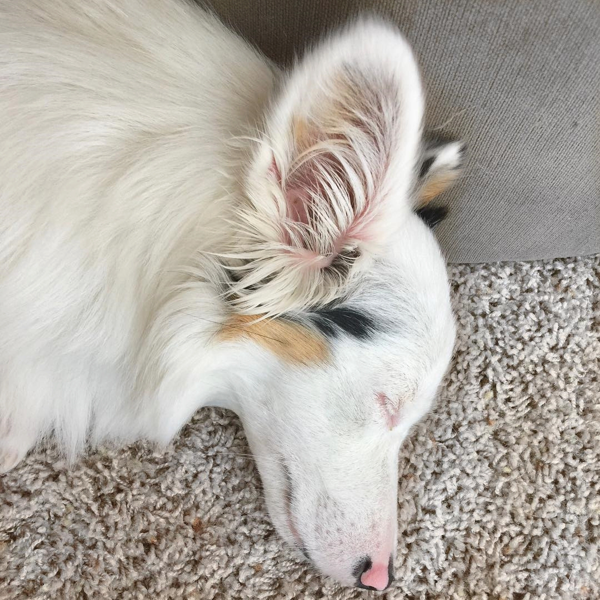

5th example



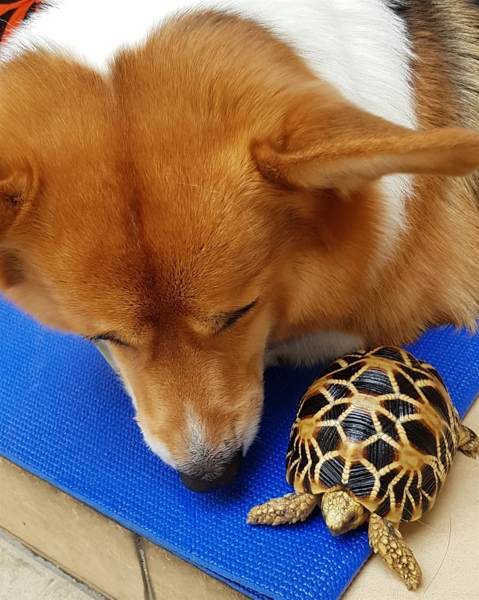
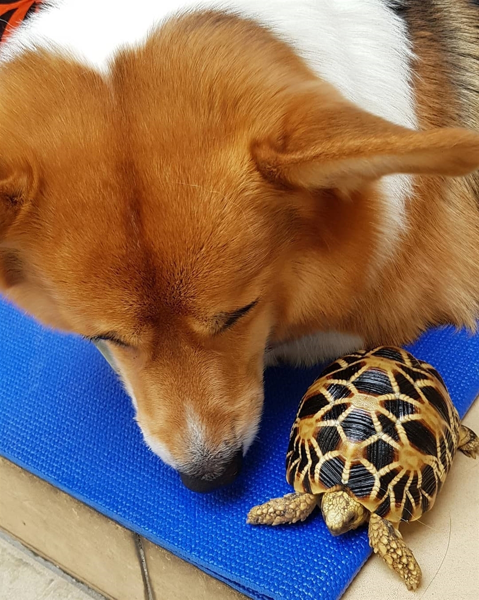

6th example



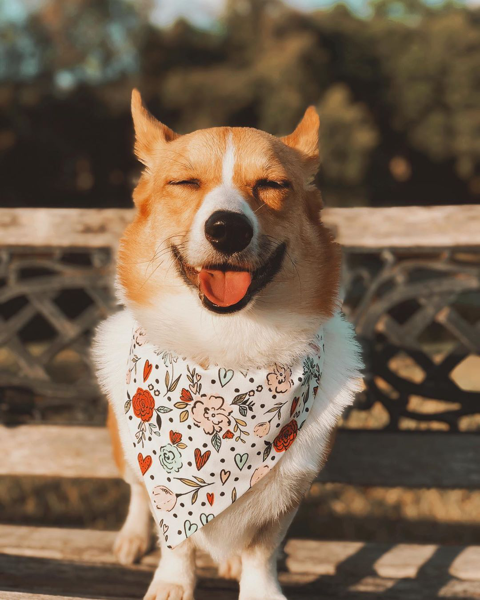
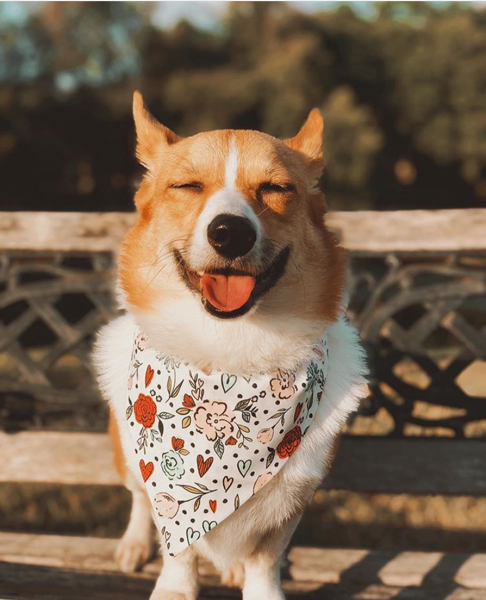

7th example



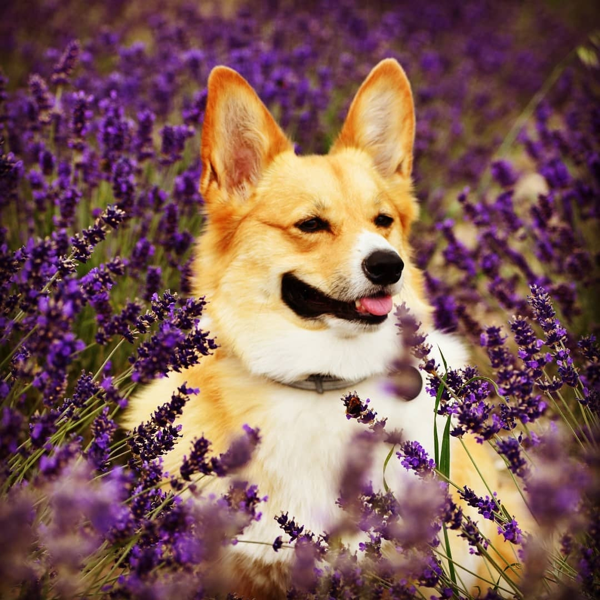
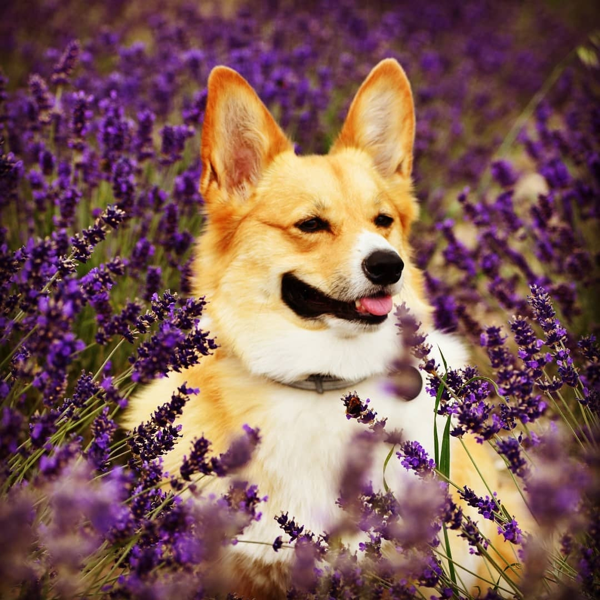

In [51]:
for i in range(7):
    print(f'{i+1}th example')
    idx = random.randint(0, len(duplicates))
    ims = [Image.open(opjoin(IMAGE_DIR, Path(x).name)) for x in duplicates[idx]]
    ipyplot.plot_images(ims, labels=[Path(x).name for x in duplicates[idx]])

In [32]:
print(f'There are {sum(len(x) - 1 for x in duplicates)} redundant images in total inside the dataset...')

There are 14903 redundant images in total inside the dataset...


In [11]:
DEL_DIR = opjoin(DATA_DIR, 'deleted')
Path(DEL_DIR).mkdir(exist_ok=True)

for dup in duplicates:
    # Keep first image of duplicate group
    for x in dup[1:]:
        stem = Path(x).stem
        try:
            os.rename(opjoin(IMAGE_DIR, stem + '.jpeg'), opjoin(DEL_DIR, stem+'.jpeg'))
            os.rename(opjoin(LABEL_DIR, stem + '.txt'), opjoin(DEL_DIR, stem+'.txt'))
        except:
            pass
        
print('Removed rundant images...')

Removed rundant images...


## **Crop Box Creation and EDA** (using *min_res=800*)

In [2]:
def draw_bbox(im, prediction, outline='red'):
    w, h = im.size
    
    w_ = prediction['w'] * w 
    h_ = prediction['h'] * h 
    x0 = prediction['x'] * w - w_/2
    y0 = prediction['y'] * h - h_/2
    x1 = x0 + prediction['w'] * w 
    y1 = y0 + prediction['h'] * h

    draw = ImageDraw.Draw(im)
    draw.rectangle([x0, y0, x1, y1], outline=outline, width=w//256)
    
    return im

Calculate quadratic crop box for each image usiiiing... multithreading!

In [27]:
if __name__ == "__main__":
    def calculate_crop_boxes(proc_num, result_dict, data, target_size, min_res):
        print(f'Process {proc_num} started...')

        crop_dicts = []
        wrong_num_pred = 0

        for d in data:
            predictions = utils.parse_prediction_file(opjoin(LABEL_DIR, d + '.txt'))
            if len(predictions) != 1: 
                wrong_num_pred += 1
                continue

            im = Image.open(opjoin(IMAGE_DIR, d + '.jpeg'))
            w, h = im.size

            crop_dict = utils.calculate_crop_box(w, h, predictions[0], target_size, min_res=min_res)

            if crop_dict is not None:
                crop_dict['sample'] = d
                crop_dicts.append(crop_dict)
            else:
                crop_dict = {}
                crop_dict['sample'] = d
                crop_dicts.append(crop_dict)

        return_dict = {'crop_dicts': crop_dicts, 'wrong_num_pred': wrong_num_pred}
        result_dict[proc_num] = return_dict

    # Partition data
    num_parts = 4
    part_size = math.ceil(len(data) / num_parts)
    data_parts = [data[i*part_size:min(len(data), (i+1)*part_size)] for i in range(num_parts)]
    print([len(data_part) for data_part in data_parts])

    # Start processes
    result_dict = {}
    jobs = []
    for i in range(num_parts):
        p = Thread(target=calculate_crop_boxes, args=[i, result_dict, data_parts[i], 1024, 800])
        jobs.append(p)
        p.start()

    # Join
    for proc in jobs:
        proc.join() 

[61847, 61847, 61847, 61845]
Process 0 started...
Process 1 started...
Process 2 started...
Process 3 started...


In [28]:
crop_dicts = []
wrong_num_pred = 0
for key in result_dict.keys():
    crop_dicts.extend(result_dict[key]['crop_dicts'])
    wrong_num_pred += result_dict[key]['wrong_num_pred']
    
print(len(crop_dicts), wrong_num_pred)

226735 20651


Create DataFrame

In [29]:
df = pd.DataFrame.from_dict(crop_dicts, orient='columns')
df.to_csv('crops_rs800.csv', index=False)
df.head()

,x,y,w,h,crop_size,crop_cover,center_shift_x,center_shift_y,is_partial,im_w,im_h,sample
0,0.370370,0.484259,0.740741,0.740741,800.0,0.279984,0.012037,0.000000,False,1080.0,1080.0,BjFaG78AUuW
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,BjfajETAxsG
2,0.474074,0.588889,0.812963,0.812963,878.0,0.673121,0.000000,0.000000,False,1080.0,1080.0,BjFaKqWgHV5
3,0.540741,0.558333,0.740741,0.740741,800.0,0.724320,0.000000,0.000000,False,1080.0,1080.0,BjfamSKA1cg
4,0.536111,0.505562,0.740741,0.988875,800.0,0.405530,0.000000,-0.033375,False,1080.0,809.0,BjfAoTLAGAf


In [ ]:
df = pd.read_csv('crops_rs800.csv')

Drop NaN rows

In [74]:
print(f'For {len(df) - len(df.dropna())} images no crop box could be calculated...')
df = df.dropna()

For 23567 images no crop box could be calculated...


In [56]:
print(len(df))

203168


### Explore Center Shift

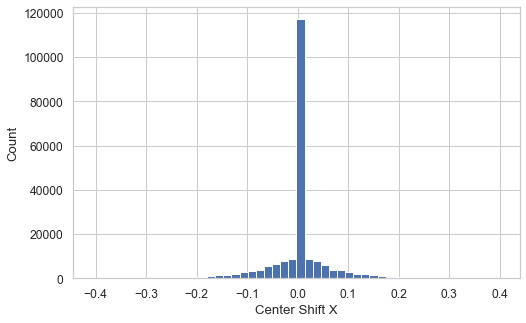

Min: -0.40438, Max: 0.39907


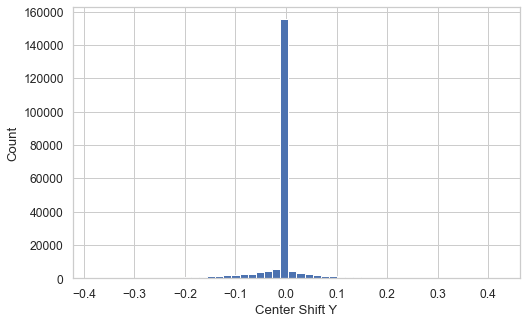

Min: -0.38101, Max: 0.42222


In [31]:
x_shift = df['center_shift_x']
y_shift = df['center_shift_y']

# x-shift histogram
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(
    x_shift, norm_hist=False, kde=False, bins=50, hist_kws={"alpha": 1}
).set(xlabel='Center Shift X', ylabel='Count')
plt.show()
print(f'Min: {x_shift.min():.5f}, Max: {x_shift.max():.5f}')

# y-shift histogram
sns.distplot(
    y_shift, norm_hist=False, kde=False, bins=50, hist_kws={"alpha": 1}
).set(xlabel='Center Shift Y', ylabel='Count')
plt.show()
print(f'Min: {y_shift.min():.5f}, Max: {y_shift.max():.5f}')

### Examples with Large Center Shift

2118 1962



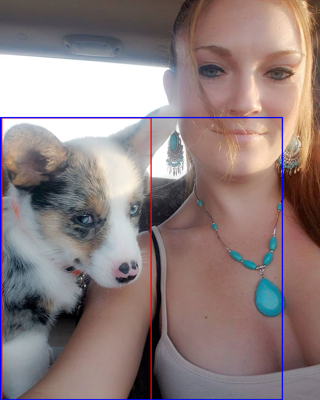
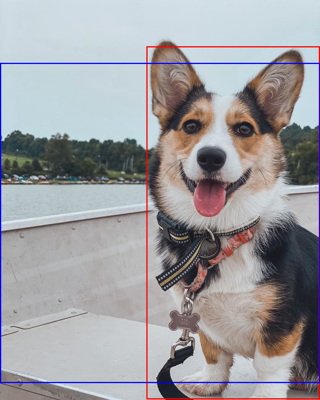
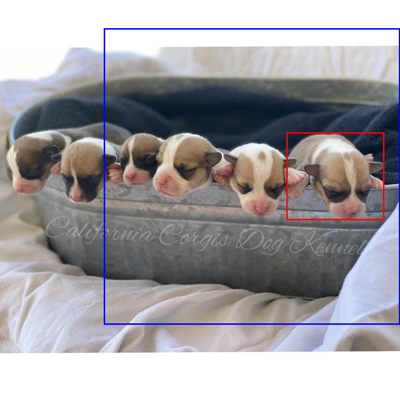
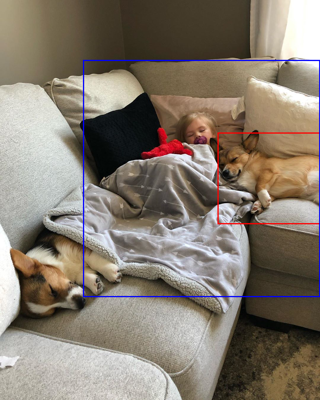
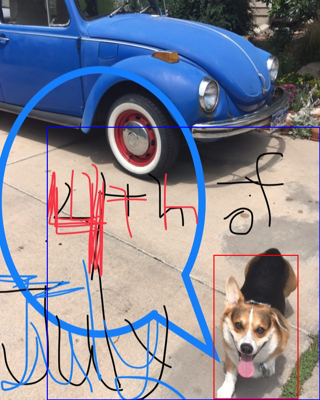
...
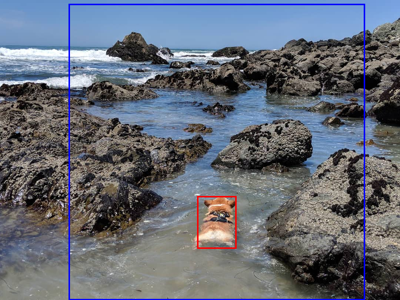
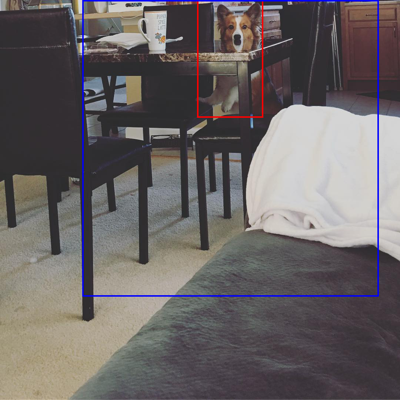
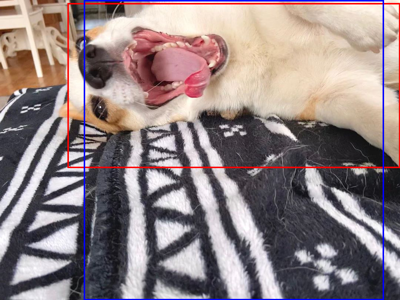
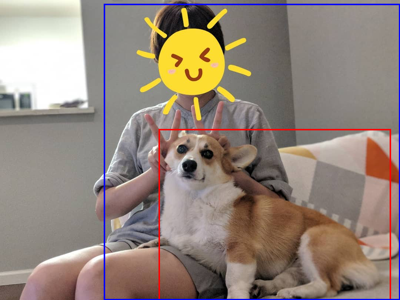
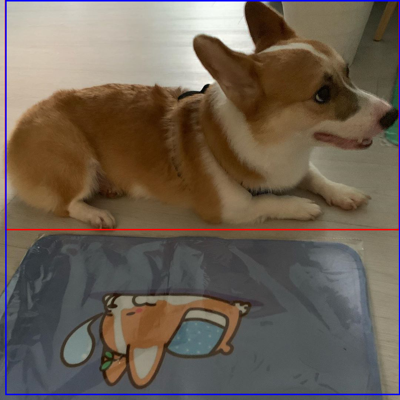

In [32]:
x_shift_large = df[x_shift.abs() > 0.2]
y_shift_large = df[y_shift.abs() > 0.2]
x_shift_large.head()

ims = []
labels=[]
for index, row in pd.concat([x_shift_large.sample(10), y_shift_large.sample(10)]).iterrows():
    predictions = utils.parse_prediction_file(opjoin(LABEL_DIR, row['sample'] + '.txt')) 
    im = Image.open(opjoin(IMAGE_DIR, row['sample'] + '.jpeg'))
    
    draw_bbox(im, predictions[0], outline='red')
    draw_bbox(im, row, outline='blue')
    
    ims.append(im)
    labels.append(row['sample'])

print(len(x_shift_large), len(y_shift_large))
ipyplot.plot_images(ims, labels=labels, img_width=200)

### Examples With Small Shift

75661 42779



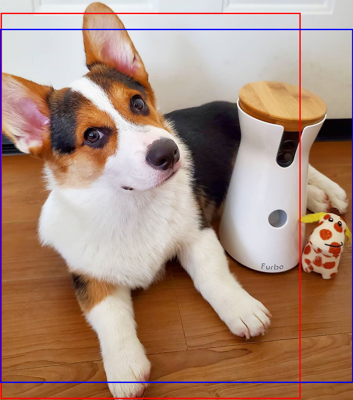
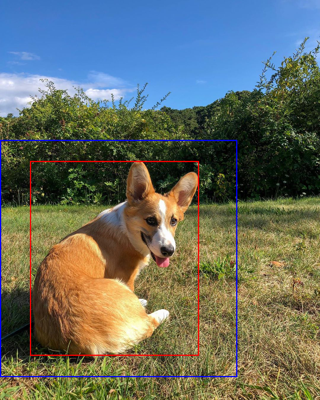
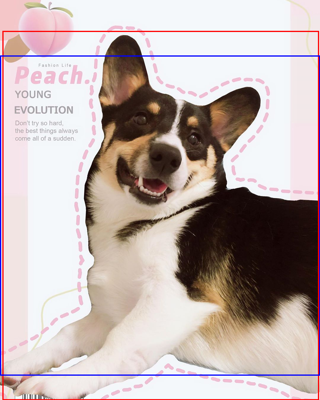
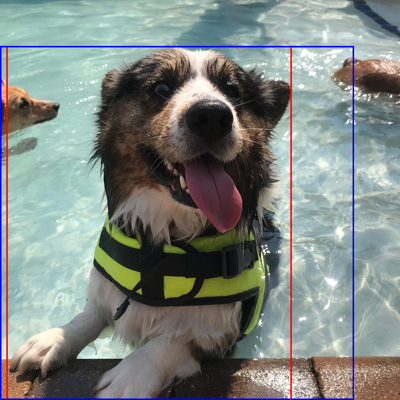
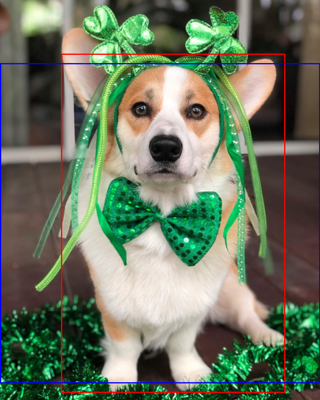
...
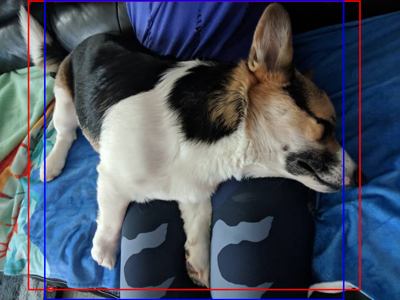
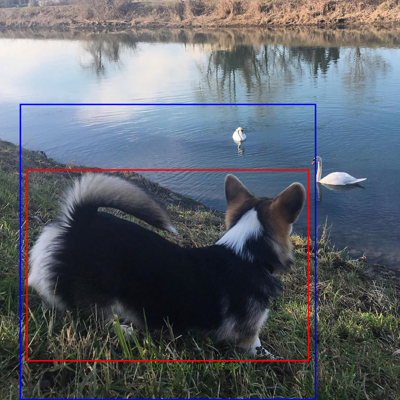
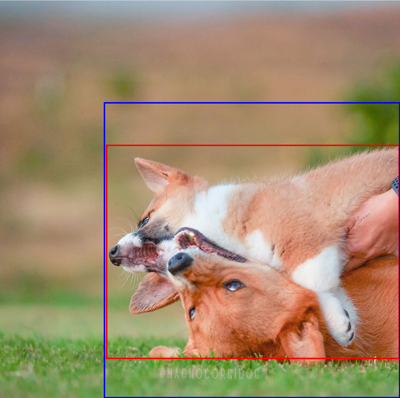
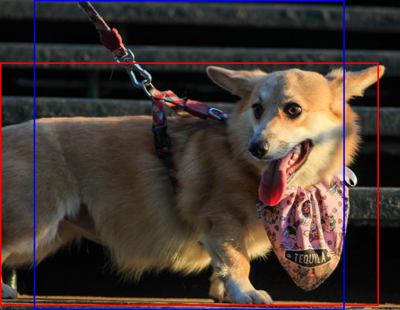
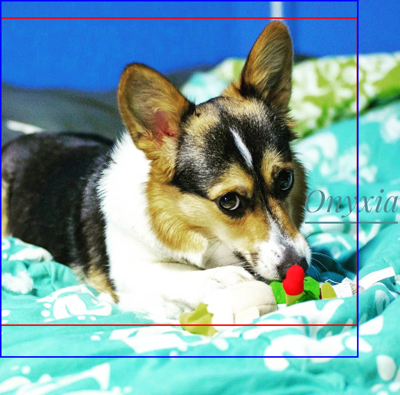

In [33]:
x_shift_small = df[(x_shift.abs() < 0.1) & (x_shift.abs() > 0.0)]
y_shift_small = df[(y_shift.abs() < 0.1) & (y_shift.abs() > 0.0)]
x_shift_small.head()

ims = []
labels=[]
for index, row in pd.concat([x_shift_small.sample(10), y_shift_small.sample(10)]).iterrows():
    predictions = utils.parse_prediction_file(opjoin(LABEL_DIR, row['sample'] + '.txt')) 
    im = Image.open(opjoin(IMAGE_DIR, row['sample'] + '.jpeg'))
    
    draw_bbox(im, predictions[0], outline='red')
    draw_bbox(im, row, outline='blue')
    
    ims.append(im)
    labels.append(row['sample'])

print(len(y_shift_small), len(y_shift_small))
ipyplot.plot_images(ims, labels=labels, img_width=200)

### Examples Without Shift

70028



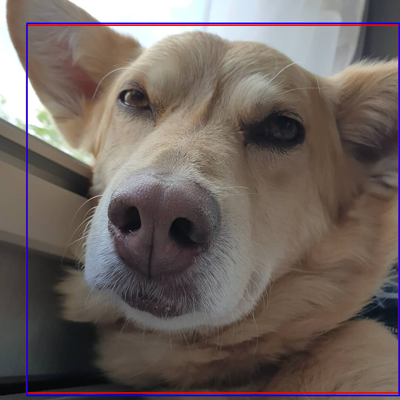
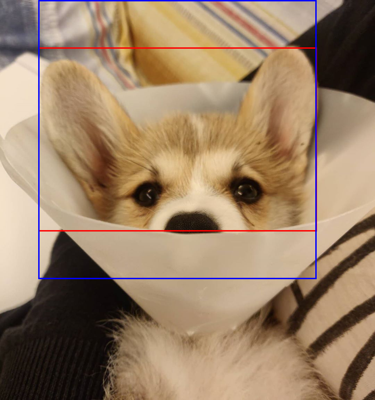
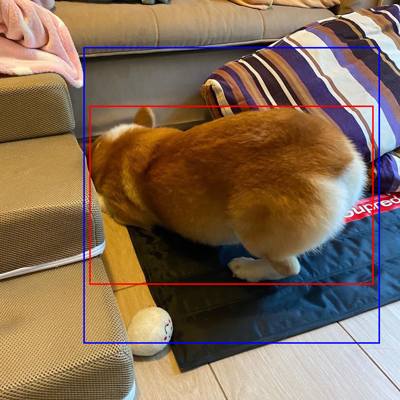
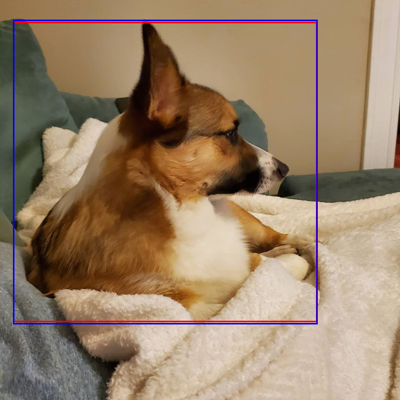
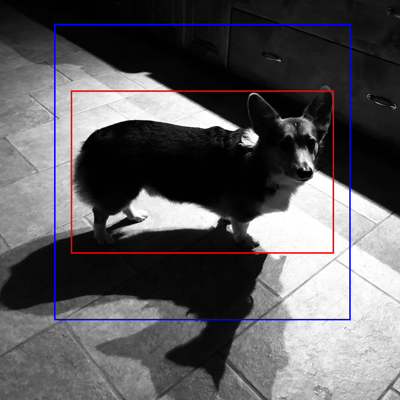
...
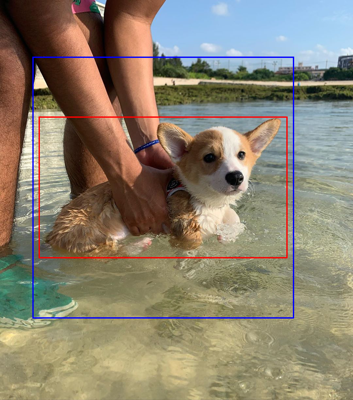
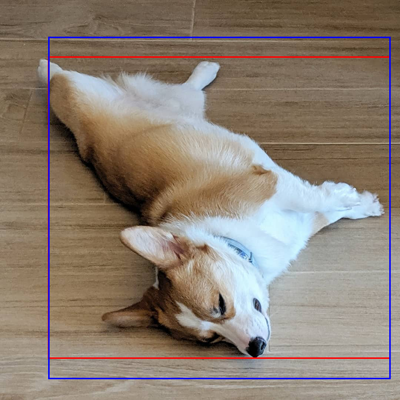
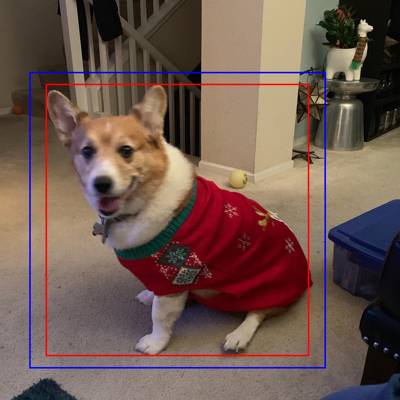
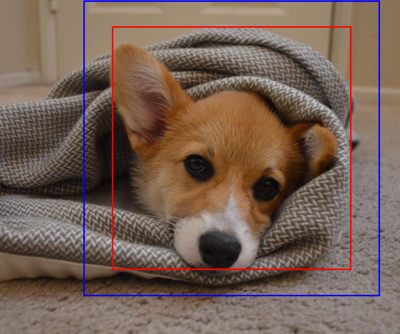
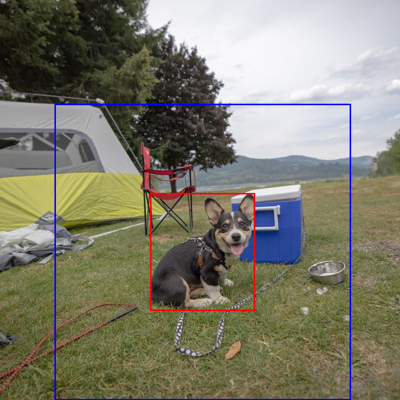

In [34]:
shift_perfect = df[(x_shift == 0.0) & (y_shift == 0.0)]
ims = []
labels = []
for index, row in shift_perfect.sample(20).iterrows():
    predictions = utils.parse_prediction_file(opjoin(LABEL_DIR, row['sample'] + '.txt')) 
    im = Image.open(opjoin(IMAGE_DIR, row['sample'] + '.jpeg'))
    
    draw_bbox(im, predictions[0], outline='red')
    draw_bbox(im, row, outline='blue')
    ims.append(im)
    labels.append(row['sample'])

print(len(shift_perfect))
ipyplot.plot_images(ims, labels=labels, img_width=200)

## Explore Coverage

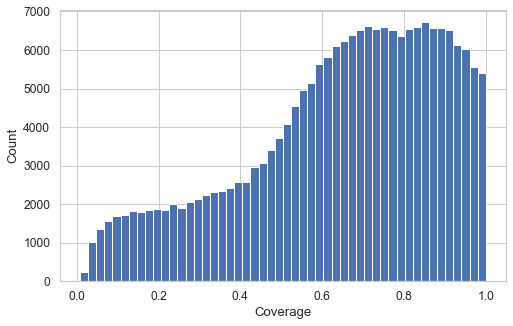

In [35]:
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(
    df['crop_cover'], norm_hist=False, kde=False, bins=50, hist_kws={"alpha": 1}
).set(xlabel='Coverage', ylabel='Count')
plt.show()

## Explore is_partial

In [27]:
df_partial = df[df['is_partial']]

df_partial_h = []
df_partial_w = []

for index, row in df_partial.iterrows():
    predictions = utils.parse_prediction_file(opjoin(LABEL_DIR, row['sample'] + '.txt'))[0]
    if predictions['h'] >= predictions['w']:
        df_partial_h.append(index)
    else:
        df_partial_w.append(index)
        
print(f'{len(df_partial)} partial crops, {len(df_partial_w)} corgis are too broad, {len(df_partial_h)} are too high')

34010 partial crops, 9273 corgis are too broad, 24737 are too high


# **Dataset Creation**

Shift partial height crops to the top of bounding box, so face of doggy is fully inside the crop...

In [80]:
for index, row in df.loc[df_partial_h].iterrows():
    predictions = utils.parse_prediction_file(opjoin(LABEL_DIR, row['sample'] + '.txt'))[0]
    w, h = image.size
    
    y_p = predictions['y'] - (predictions['h']/2)
    y_c = row['y'] - (row['h'] / 2)
    
    if y_p < y_c:
        df.loc[index, 'y'] = y_p + (row['h'] / 2)
        
print(f'Updated {len(df_partial_h)} bounding boxes')

Updated 24737 bounding boxes


Filter dataframe based on coverage, shift and is_partial...

In [81]:
min_coverage = 0.5
max_shift = 0.1

df_final = df.drop(df_partial_w)
print(len(df), len(df_final))

df_final = df[df['crop_cover'] >= min_coverage]
print(f'{len(df_final)} have required coverage...')

shift_mask = np.logical_and(df_final['center_shift_x'].abs() <= max_shift, df_final['center_shift_y'].abs() <= max_shift)
print(f'Out of these, {shift_mask.sum()} have center shift x,y < {max_shift}')
df_final = df[shift_mask]

203168 193895
151528 have required coverage...
Out of these, 136255 have center shift x,y < 0.1


Crop and save!

In [85]:
import PIL
from pathlib import Path
path_512 = os.path.join(DATA_DIR, 'crop512')
path_1024 = os.path.join(DATA_DIR, 'crop1024')
Path(path_512).mkdir(parents=True, exist_ok=True)
Path(path_1024).mkdir(parents=True, exist_ok=True)

for index, row in tqdm(df_final.iterrows()):
    if os.path.isfile(os.path.join(path_512, row['sample'] + '.jpeg')) and os.path.isfile(os.path.join(path_1024, row['sample'] + '.jpeg')):
        continue

    image = Image.open(opjoin(IMAGE_DIR, row['sample'] + '.jpeg'))
    w, h = image.size
    
    crop_size = row['crop_size']
    w_ = crop_size
    h_ = crop_size
    x = int(row['x'] * w - w_/2)
    y = int(row['y'] * h - h_/2)
    x2 = x + w_
    y2 = y + h_
    
    assert x2 - x == y2 - y
    assert x >= 0.0 and y >= 0.0 and x2 <= w and y2 <= h, print(x, y, x2, y2, w, h)
    
    crop = image.crop((x, y, x2, y2))
    crop512 = crop.resize((512, 512), resample=PIL.Image.LANCZOS)
    crop1024 = crop.resize((1024, 1024), resample=PIL.Image.LANCZOS)
    
    crop512.save(os.path.join(path_512, row['sample'] + '.jpeg'))
    crop1024.save(os.path.join(path_1024, row['sample'] + '.jpeg'))

151528it [6:58:11,  6.04it/s]


Finished! Zippen und ab geht die Post!

In [97]:
import shutil
print('Zipping 512 archive...')
shutil.make_archive(path_512, 'zip', path_512)
print('Zipping 1024 archive...')
shutil.make_archive(path_1024, 'zip', path_1024)

Zipping 512 archive...
Zipping 1024 archive...


'H:\\dataset\\crop1024.zip'

In [96]:
for index, row in df_final.loc[~shift_mask].iterrows():
    os.remove(os.path.join(path_512, row['sample'] + '.jpeg'))
    os.remove(os.path.join(path_1024, row['sample'] + '.jpeg'))